<a href="https://colab.research.google.com/github/Sanaullahiu/Assignment-on-Cross-Validation/blob/main/Final_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Hi, I am Sanaullah. In this kernel i will be apply Machine Learning Classifications Algorithms for the prediction of Heart-Disease



# **1. Import All necessary Liabaries**

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
import warnings 
warnings.filterwarnings('ignore')

# **2. Import Dataset**

In [ ]:
from google.colab import files
files.upload()

Saving Heart Disease.csv to Heart Disease.csv


{'Heart Disease.csv': b'HeartDisease,BMI,Smoking,AlcoholDrinking,Stroke,PhysicalHealth,MentalHealth,DiffWalking,Sex,AgeCategory,Race,Diabetic,PhysicalActivity,GenHealth,SleepTime,Asthma,KidneyDisease,SkinCancer\r\nNo,16.6,Yes,No,No,3,30,No,Female,55-59,White,Yes,Yes,Very good,5,Yes,No,Yes\r\nNo,20.34,No,No,Yes,0,0,No,Female,80 or older,White,No,Yes,Very good,7,No,No,No\r\nNo,26.58,Yes,No,No,20,30,No,Male,65-69,White,Yes,Yes,Fair,8,Yes,No,No\r\nNo,24.21,No,No,No,0,0,No,Female,75-79,White,No,No,Good,6,No,No,Yes\r\nNo,23.71,No,No,No,28,0,Yes,Female,40-44,White,No,Yes,Very good,8,No,No,No\r\nYes,28.87,Yes,No,No,6,0,Yes,Female,75-79,Black,No,No,Fair,12,No,No,No\r\nNo,21.63,No,No,No,15,0,No,Female,70-74,White,No,Yes,Fair,4,Yes,No,Yes\r\nNo,31.64,Yes,No,No,5,0,Yes,Female,80 or older,White,Yes,No,Good,9,Yes,No,No\r\nNo,26.45,No,No,No,0,0,No,Female,80 or older,White,"No, borderline diabetes",No,Fair,5,No,Yes,No\r\nNo,40.69,No,No,No,0,0,Yes,Male,65-69,White,No,Yes,Good,10,No,No,No\r\nYes,34.3,Ye

In [ ]:
df=pd.read_csv('Heart Disease.csv')
df.head()

,HeartDisease,BMI,Smoking,AlcoholDrinking,Stroke,PhysicalHealth,MentalHealth,DiffWalking,Sex,AgeCategory,Race,Diabetic,PhysicalActivity,GenHealth,SleepTime,Asthma,KidneyDisease,SkinCancer
0,No,16.60,Yes,No,No,3,30,No,Female,55-59,White,Yes,Yes,Very good,5,Yes,No,Yes
1,No,20.34,No,No,Yes,0,0,No,Female,80 or older,White,No,Yes,Very good,7,No,No,No
2,No,26.58,Yes,No,No,20,30,No,Male,65-69,White,Yes,Yes,Fair,8,Yes,No,No
3,No,24.21,No,No,No,0,0,No,Female,75-79,White,No,No,Good,6,No,No,Yes
4,No,23.71,No,No,No,28,0,Yes,Female,40-44,White,No,Yes,Very good,8,No,No,No


# **3. Explaratory Data Analysis**

In [ ]:
#Showing Shape of Dataset

df.shape

(319795, 18)

In [ ]:
#showing Description of of Dataset

df.describe()

,BMI,PhysicalHealth,MentalHealth,SleepTime
count,319795.000000,319795.00000,319795.000000,319795.000000
mean,28.325399,3.37171,3.898366,7.097075
std,6.356100,7.95085,7.955235,1.436007
min,12.020000,0.00000,0.000000,1.000000
25%,24.030000,0.00000,0.000000,6.000000
50%,27.340000,0.00000,0.000000,7.000000
75%,31.420000,2.00000,3.000000,8.000000
max,94.850000,30.00000,30.000000,24.000000


In [ ]:
#Showing Info of Dataset

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 319795 entries, 0 to 319794
Data columns (total 18 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   HeartDisease      319795 non-null  object 
 1   BMI               319795 non-null  float64
 2   Smoking           319795 non-null  object 
 3   AlcoholDrinking   319795 non-null  object 
 4   Stroke            319795 non-null  object 
 5   PhysicalHealth    319795 non-null  int64  
 6   MentalHealth      319795 non-null  int64  
 7   DiffWalking       319795 non-null  object 
 8   Sex               319795 non-null  object 
 9   AgeCategory       319795 non-null  object 
 10  Race              319795 non-null  object 
 11  Diabetic          319795 non-null  object 
 12  PhysicalActivity  319795 non-null  object 
 13  GenHealth         319795 non-null  object 
 14  SleepTime         319795 non-null  int64  
 15  Asthma            319795 non-null  object 
 16  KidneyDisease     31

In the Above Description, I have been seen that 14 column are contain categorical Variables and 4 columns are contain numerical Variables .

In [ ]:
#Checking null Values in the Datset

df.isnull().sum()

HeartDisease        0
BMI                 0
Smoking             0
AlcoholDrinking     0
Stroke              0
PhysicalHealth      0
MentalHealth        0
DiffWalking         0
Sex                 0
AgeCategory         0
Race                0
Diabetic            0
PhysicalActivity    0
GenHealth           0
SleepTime           0
Asthma              0
KidneyDisease       0
SkinCancer          0
dtype: int64

In [ ]:
#Checking Unique_Values 

df.nunique()

HeartDisease           2
BMI                 3604
Smoking                2
AlcoholDrinking        2
Stroke                 2
PhysicalHealth        31
MentalHealth          31
DiffWalking            2
Sex                    2
AgeCategory           13
Race                   6
Diabetic               4
PhysicalActivity       2
GenHealth              5
SleepTime             24
Asthma                 2
KidneyDisease          2
SkinCancer             2
dtype: int64

In [ ]:
#Drop Duplicate Value's If any

df.drop_duplicates(inplace=True)

In [ ]:
# Check again the shape of Dataset

df.shape

(301717, 18)

**3.1 Visulaization of categorical Features**

In [ ]:
font1={'family':'arial','size':'16','color':'black'}
sns.set(rc={'figure.figsize':(9,5)})

findfont: Font family ['arial'] not found. Falling back to DejaVu Sans.


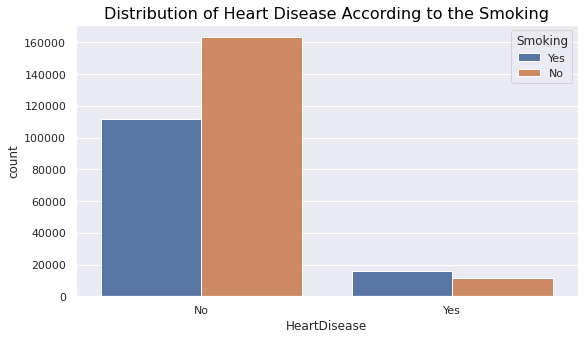

In [ ]:
plt.title('Distribution of Heart Disease According to the Smoking',fontdict=font1)
sns.countplot(x='HeartDisease', data=df, hue='Smoking')

In [ ]:
print( df.Smoking.value_counts())

No     174312
Yes    127405
Name: Smoking, dtype: int64


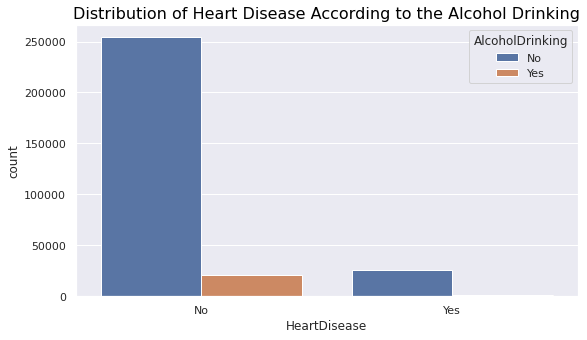

In [ ]:
plt.title('Distribution of Heart Disease According to the Alcohol Drinking',fontdict=font1)
sns.countplot(x='HeartDisease', data=df, hue='AlcoholDrinking')

In [ ]:
print( df.AlcoholDrinking.value_counts())

No     280136
Yes     21581
Name: AlcoholDrinking, dtype: int64


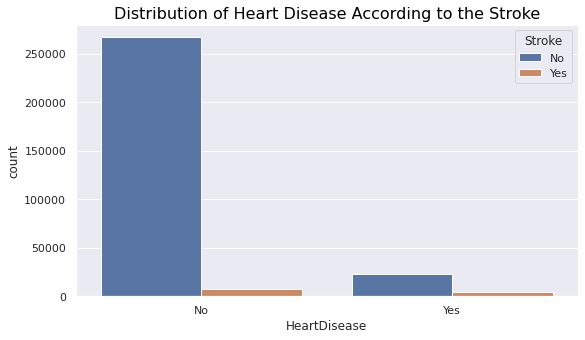

In [ ]:
plt.title('Distribution of Heart Disease According to the Stroke',fontdict=font1)
sns.countplot(x='HeartDisease', data=df, hue='Stroke')

In [ ]:
print( df.Stroke.value_counts())

No     289653
Yes     12064
Name: Stroke, dtype: int64


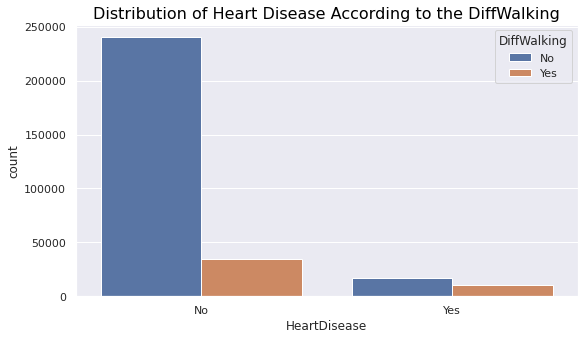

In [ ]:
plt.title('Distribution of Heart Disease According to the DiffWalking',fontdict=font1)
sns.countplot(x='HeartDisease', data=df, hue='DiffWalking')

In [ ]:
print( df.DiffWalking.value_counts())

No     257362
Yes     44355
Name: DiffWalking, dtype: int64


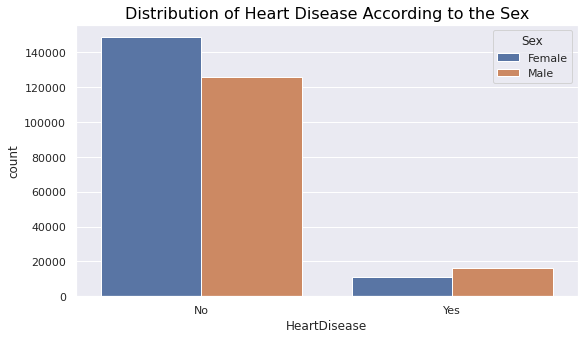

In [ ]:
plt.title('Distribution of Heart Disease According to the Sex',fontdict=font1)
sns.countplot(x='HeartDisease', data=df, hue='Sex')

In [ ]:
print( df.Sex.value_counts())

Female    159671
Male      142046
Name: Sex, dtype: int64


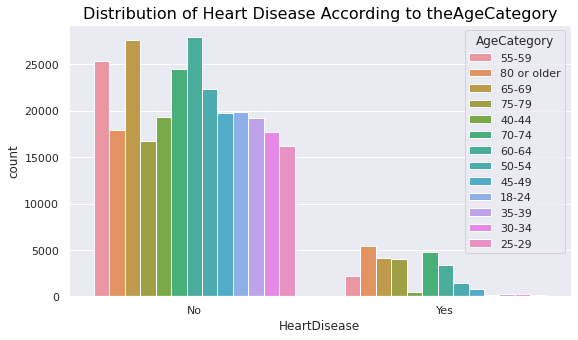

In [ ]:
plt.title('Distribution of Heart Disease According to theAgeCategory',fontdict=font1)
sns.countplot(x='HeartDisease', data=df, hue='AgeCategory')

In [ ]:
print( df.AgeCategory.value_counts())

65-69          31670
60-64          31219
70-74          29273
55-59          27610
50-54          23736
80 or older    23352
75-79          20713
45-49          20518
18-24          19998
40-44          19837
35-39          19526
30-34          17953
25-29          16312
Name: AgeCategory, dtype: int64


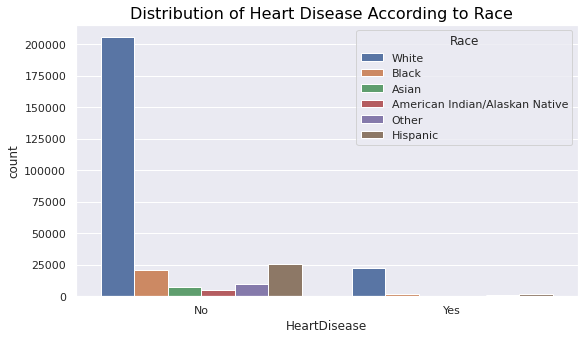

In [ ]:
plt.title('Distribution of Heart Disease According to Race  ',fontdict=font1)
sns.countplot(x='HeartDisease', data=df, hue='Race')

In [ ]:
print( df.Race.value_counts())

White                             227724
Hispanic                           27107
Black                              22810
Other                              10891
Asian                               7993
American Indian/Alaskan Native      5192
Name: Race, dtype: int64


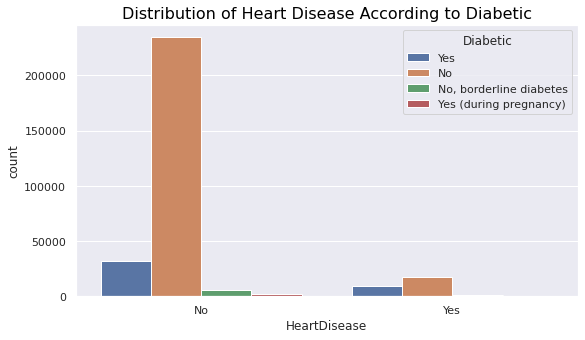

In [ ]:
plt.title('Distribution of Heart Disease According to Diabetic',fontdict=font1)
sns.countplot(x='HeartDisease', data=df, hue='Diabetic')

In [ ]:
print( df.Diabetic.value_counts())

No                         251796
Yes                         40589
No, borderline diabetes      6776
Yes (during pregnancy)       2556
Name: Diabetic, dtype: int64


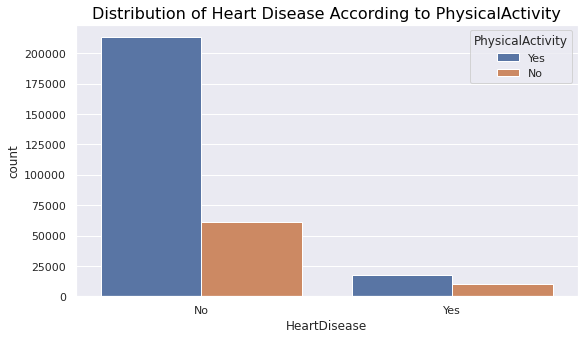

In [ ]:
plt.title('Distribution of Heart Disease According to PhysicalActivity',fontdict=font1)
sns.countplot(x='HeartDisease', data=df, hue='PhysicalActivity')

In [ ]:
print( df.PhysicalActivity.value_counts())

Yes    230412
No      71305
Name: PhysicalActivity, dtype: int64


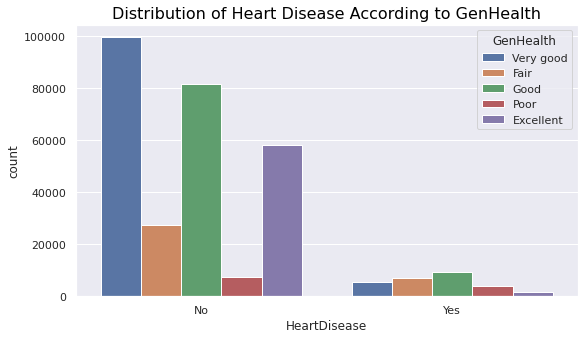

In [ ]:
plt.title('Distribution of Heart Disease According to GenHealth',fontdict=font1)
sns.countplot(x='HeartDisease', data=df, hue='GenHealth')

In [ ]:
print( df.GenHealth.value_counts())

Very good    104796
Good          91239
Excellent     59737
Fair          34659
Poor          11286
Name: GenHealth, dtype: int64


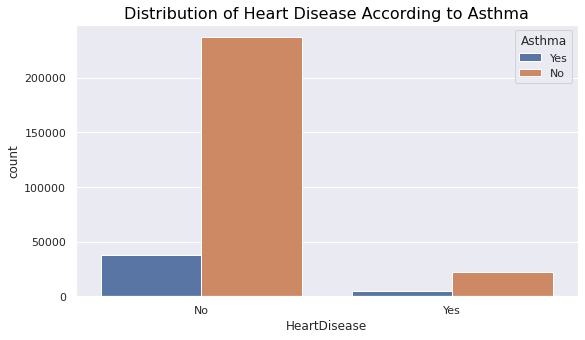

In [ ]:
plt.title('Distribution of Heart Disease According to Asthma',fontdict=font1)
sns.countplot(x='HeartDisease', data=df, hue='Asthma')

In [ ]:
print( df.Asthma.value_counts())

No     259066
Yes     42651
Name: Asthma, dtype: int64


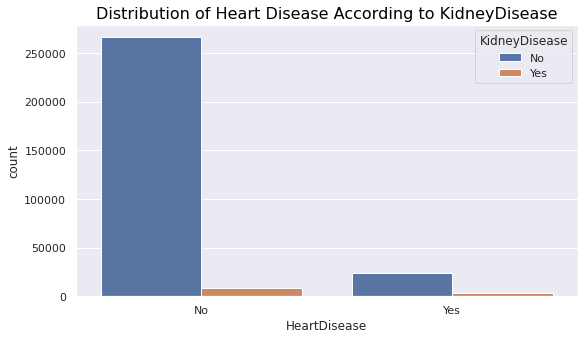

In [ ]:
plt.title('Distribution of Heart Disease According to KidneyDisease',fontdict=font1)
sns.countplot(x='HeartDisease', data=df, hue='KidneyDisease')

In [ ]:
print( df.KidneyDisease.value_counts())

No     289941
Yes     11776
Name: KidneyDisease, dtype: int64


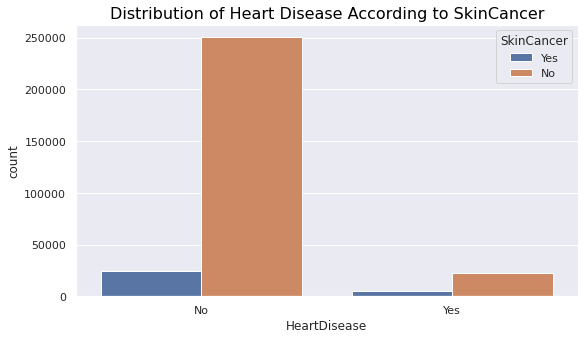

In [ ]:
plt.title('Distribution of Heart Disease According to SkinCancer',fontdict=font1)
sns.countplot(x='HeartDisease', data=df, hue='SkinCancer')

In [ ]:
print( df.SkinCancer.value_counts())

No     272425
Yes     29292
Name: SkinCancer, dtype: int64


**3.2 Visulaization of Numerical Features**

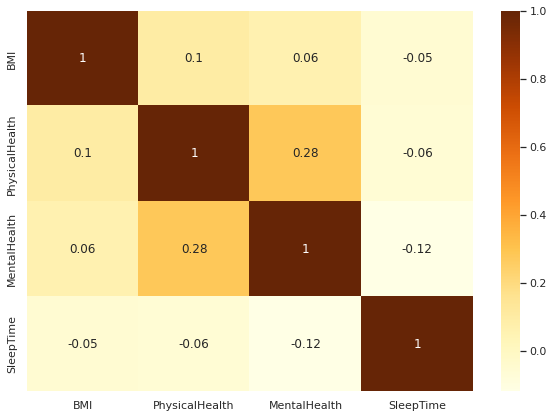

In [ ]:
correlation = df.corr().round(2)
plt.figure(figsize = (10,7))
sns.heatmap(correlation, annot = True, cmap = 'YlOrBr')

From the Visulaization analysis I have been observed that the imported Dataset is Imbalance. So, I will be balanced this dataset with the help of Data balancing Techniques

# **4. Preprocessing Data**

For the Features Transform we can use various types of Method Like: LabelEncoder, OneHotEncoding and OrnialEncoding Etc. We can also use "Replace Function" for the Feature Transform

In [ ]:
df.head()

,HeartDisease,BMI,Smoking,AlcoholDrinking,Stroke,PhysicalHealth,MentalHealth,DiffWalking,Sex,AgeCategory,Race,Diabetic,PhysicalActivity,GenHealth,SleepTime,Asthma,KidneyDisease,SkinCancer
0,No,16.60,Yes,No,No,3,30,No,Female,55-59,White,Yes,Yes,Very good,5,Yes,No,Yes
1,No,20.34,No,No,Yes,0,0,No,Female,80 or older,White,No,Yes,Very good,7,No,No,No
2,No,26.58,Yes,No,No,20,30,No,Male,65-69,White,Yes,Yes,Fair,8,Yes,No,No
3,No,24.21,No,No,No,0,0,No,Female,75-79,White,No,No,Good,6,No,No,Yes
4,No,23.71,No,No,No,28,0,Yes,Female,40-44,White,No,Yes,Very good,8,No,No,No


In [ ]:
#Import LabelEncoder 


from sklearn.preprocessing import LabelEncoder
label=LabelEncoder()

In [ ]:
from pandas.core.dtypes.common import is_numeric_dtype
for column in df.columns:
    if is_numeric_dtype(df[column]):
        continue
    else:
        df[column]=label.fit_transform(df[column])

In [ ]:
df.head()

,HeartDisease,BMI,Smoking,AlcoholDrinking,Stroke,PhysicalHealth,MentalHealth,DiffWalking,Sex,AgeCategory,Race,Diabetic,PhysicalActivity,GenHealth,SleepTime,Asthma,KidneyDisease,SkinCancer
0,0,16.60,1,0,0,3,30,0,0,7,5,2,1,4,5,1,0,1
1,0,20.34,0,0,1,0,0,0,0,12,5,0,1,4,7,0,0,0
2,0,26.58,1,0,0,20,30,0,1,9,5,2,1,1,8,1,0,0
3,0,24.21,0,0,0,0,0,0,0,11,5,0,0,2,6,0,0,1
4,0,23.71,0,0,0,28,0,1,0,4,5,0,1,4,8,0,0,0


I have been seen that the values in every columns is not a large value. So We Don't need to use Scaling Techniques. But, If Anyone want than it can be.

**4.1 Seperate Dependent And Independent Variables**

In [ ]:
x=df.drop('HeartDisease', axis=1)
y=df['HeartDisease']

In [ ]:
x.head()

,BMI,Smoking,AlcoholDrinking,Stroke,PhysicalHealth,MentalHealth,DiffWalking,Sex,AgeCategory,Race,Diabetic,PhysicalActivity,GenHealth,SleepTime,Asthma,KidneyDisease,SkinCancer
0,16.60,1,0,0,3,30,0,0,7,5,2,1,4,5,1,0,1
1,20.34,0,0,1,0,0,0,0,12,5,0,1,4,7,0,0,0
2,26.58,1,0,0,20,30,0,1,9,5,2,1,1,8,1,0,0
3,24.21,0,0,0,0,0,0,0,11,5,0,0,2,6,0,0,1
4,23.71,0,0,0,28,0,1,0,4,5,0,1,4,8,0,0,0


In [ ]:
x.shape

(301717, 17)

In [ ]:
y.head()

0    0
1    0
2    0
3    0
4    0
Name: HeartDisease, dtype: int64

From the above analysis I have been Clearly noticed that this Dataset is Imbalanced Dataset. So, I need to balanced this Dataset. I am doing this in the below sections.

**4.2 Imbalance Data Handling**

Checking Balancing of Datase

In [ ]:
df.HeartDisease.value_counts()

0    274456
1     27261
Name: HeartDisease, dtype: int64

Now ,I am using OverSampling Method for the Balancing of Dataset

In [ ]:
from imblearn.over_sampling import RandomOverSampler
over=RandomOverSampler()

In [ ]:
x_new , y_new = over.fit_resample(x,y)

In [ ]:
x_new.shape

(548912, 17)

In [ ]:
y_new.shape

(548912,)

In [ ]:
y_new.value_counts()

0    274456
1    274456
Name: HeartDisease, dtype: int64

# **5. Split The Balanced Dataset**

Now I need to Split my Dataset. I am doing it.

In [ ]:
from sklearn.model_selection import train_test_split 
xtrain,xtest,ytrain,ytest=train_test_split(x_new,y_new,test_size=0.3)

In [ ]:
xtrain.head()

,BMI,Smoking,AlcoholDrinking,Stroke,PhysicalHealth,MentalHealth,DiffWalking,Sex,AgeCategory,Race,Diabetic,PhysicalActivity,GenHealth,SleepTime,Asthma,KidneyDisease,SkinCancer
336794,25.70,0,0,0,0,0,0,1,9,3,2,1,4,7,0,0,0
232270,31.00,1,1,0,0,2,0,0,10,5,0,1,2,9,1,0,0
91805,43.05,1,0,0,0,0,0,0,6,5,0,1,2,6,0,0,0
174868,22.49,1,0,0,0,0,0,0,12,5,0,1,2,8,0,0,0
19797,18.30,0,0,0,0,0,0,0,10,5,0,1,0,7,1,0,0


In [ ]:
xtrain.shape

(384238, 17)

In [ ]:
ytrain.head()

336794    1
232270    0
91805     0
174868    1
19797     0
Name: HeartDisease, dtype: int64

In [ ]:
ytrain.shape

(384238,)

In [ ]:
xtest.head()

,BMI,Smoking,AlcoholDrinking,Stroke,PhysicalHealth,MentalHealth,DiffWalking,Sex,AgeCategory,Race,Diabetic,PhysicalActivity,GenHealth,SleepTime,Asthma,KidneyDisease,SkinCancer
539499,21.21,1,0,0,0,3,0,0,11,5,0,1,4,7,0,0,0
330187,29.84,1,0,0,5,0,0,1,5,5,0,1,2,8,0,0,0
212430,25.84,0,0,0,0,0,0,1,12,5,0,1,4,6,0,0,0
339526,23.23,0,0,0,0,0,0,0,10,5,0,1,4,7,0,0,0
445162,24.89,1,0,0,0,0,1,0,8,5,2,0,1,12,0,0,0


In [ ]:
xtest.shape

(164674, 17)

In [ ]:
ytest.head()

539499    1
330187    1
212430    0
339526    1
445162    1
Name: HeartDisease, dtype: int64

In [ ]:
ytest.shape

(164674,)

# **6. Model Evaluation**

# **6.1 Decision Tree Algorithm**

In [ ]:
from sklearn.tree import DecisionTreeClassifier 
DTC=DecisionTreeClassifier()

In [ ]:
DTC.fit(xtrain,ytrain)

DecisionTreeClassifier()

In [ ]:
y_pred=DTC.predict(xtest)
y_pred

array([1, 1, 1, ..., 0, 0, 1])

In [ ]:
#The Accuracy Score for the DecissionTreeClassifier 

print('The Accuracy for the Decission tree is:  ', DTC.score(xtest,ytest))

The Accuracy for the Decission tree is:   0.9483403573120225


Now, I will see The confussion_metrix for the Decission Tree Classifier. The Confussion_metrix is Included below:

In [ ]:
from sklearn.metrics import accuracy_score,classification_report,plot_roc_curve, confusion_matrix

In [ ]:
print(classification_report(ytest,y_pred))

              precision    recall  f1-score   support

           0       1.00      0.90      0.95     82289
           1       0.91      1.00      0.95     82385

    accuracy                           0.95    164674
   macro avg       0.95      0.95      0.95    164674
weighted avg       0.95      0.95      0.95    164674



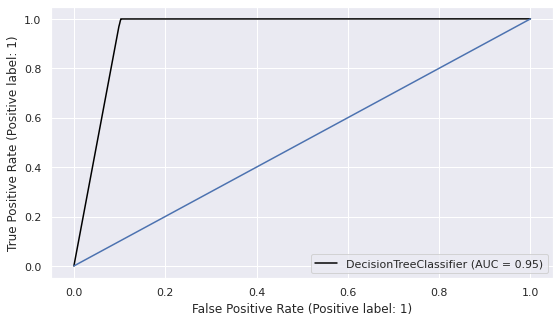

In [ ]:
plot_roc_curve(DTC,xtest,ytest,color='black')
plt.plot([0,1],[0,1])

Text(57.5, 0.5, 'Actual Values')

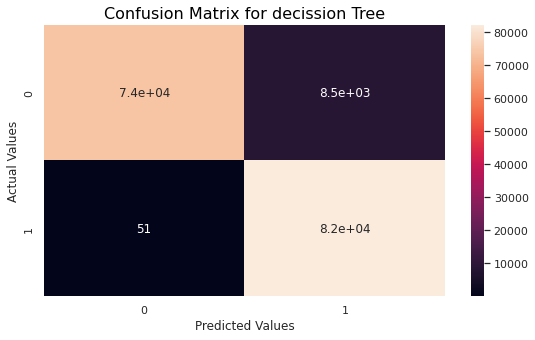

In [ ]:
#Showing "Confusion Matrix:
cm=confusion_matrix(ytest, y_pred)

sns.heatmap(cm,annot=True)
plt.title('Confusion Matrix for decission Tree',fontdict=font1)
plt.xlabel('Predicted Values')
plt.ylabel('Actual Values')

In [ ]:
# Now checking Overfit and underfit of model accuracy

print('The Accuracy Score for the training data is:', DTC.score(xtrain,ytrain))
print('The Accuracy Score for the test data is:', DTC.score(xtest,ytest))

The Accuracy Score for the training data is: 0.9978893290096242
The Accuracy Score for the test data is: 0.9483403573120225


**6.1.1 Using K Fold Cross Validation for Decision Tree**

In [ ]:
from sklearn.model_selection import KFold, cross_val_score

In [ ]:
kfold = KFold(n_splits=5) #each fold contain 20% data

In [ ]:
Decision_Tree_result = cross_val_score(DTC,x_new,y_new,cv=kfold) 
Decision_Tree_result

array([0.89827205, 0.90260787, 0.9323022 , 0.9997996 , 0.99978138])

In [ ]:
Decision_Tree_result.min()

0.8982720457630052

In [ ]:
Decision_Tree_result.max()

0.9997996028492832

In [ ]:
Decision_Tree_result.mean()

0.9465526208669587

**6.1.2 Now, I am using Stratified k fold cross Validation for DecisionTree**

In [ ]:
from sklearn.model_selection import StratifiedKFold

In [ ]:
Skfold = StratifiedKFold(n_splits=5)
Decision_result1= cross_val_score(DTC,x_new,y_new,cv=Skfold)
Decision_result1

array([0.95100334, 0.95182314, 0.95210508, 0.95338034, 0.95452806])

In [ ]:
Decision_result1.min()

0.9510033429583815

In [ ]:
Decision_result1.max()

0.9545280647100618

In [ ]:
Decision_result1.mean()

0.9525679932475543

**with and without cross Validation Results are mentioned Below:**


In [ ]:
print('The Accuracy score without using cross_Validation is: ', DTC.score(xtest,ytest))
print('The Accuracy Score for the K-Fold Cross_validation is:',Decision_Tree_result.mean())
print('The Accuracy Score for the Stratified K-fold Cross_validation is:',Decision_result1.mean())

The Accuracy score without using cross_Validation is:  0.9483403573120225
The Accuracy Score for the K-Fold Cross_validation is: 0.9465526208669587
The Accuracy Score for the Stratified K-fold Cross_validation is: 0.9525679932475543


# **6.2 LogisticRegression Algorithm**

In [ ]:
from sklearn.linear_model import LogisticRegression
logReg=LogisticRegression()

In [ ]:
logReg.fit(xtrain,ytrain)

LogisticRegression()

In [ ]:
y_pred_logReg=logReg.predict(xtest)
y_pred_logReg

array([1, 1, 0, ..., 1, 0, 1])

In [ ]:
y_pred_logReg.shape

(164674,)

In [ ]:
Log_score=logReg.score(xtest,ytest)
print('The Accuracy for the Logistic Regression is:  ', Log_score)

The Accuracy for the Logistic Regression is:   0.7438697062074159


In [ ]:
from sklearn.metrics import accuracy_score,classification_report,plot_roc_curve

In [ ]:
print(classification_report(ytest,y_pred_logReg))

              precision    recall  f1-score   support

           0       0.75      0.73      0.74     82285
           1       0.74      0.76      0.75     82389

    accuracy                           0.74    164674
   macro avg       0.74      0.74      0.74    164674
weighted avg       0.74      0.74      0.74    164674



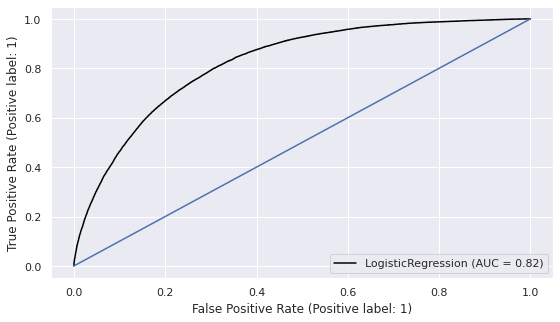

In [ ]:
plot_roc_curve(logReg,xtest,ytest,color='black')
plt.plot([0,1],[0,1])

In [ ]:
print('The Accuracy Score for the training data is:', logReg.score(xtrain,ytrain))
print('The Accuracy Score for the test data is:', logReg.score(xtest,ytest))

The Accuracy Score for the training data is: 0.7443355420338436
The Accuracy Score for the test data is: 0.7438697062074159


Text(57.5, 0.5, 'Actual Values')

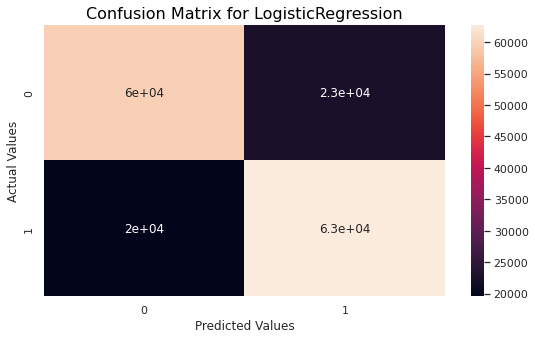

In [ ]:
cm1=confusion_matrix(ytest, y_pred_logReg)

sns.heatmap(cm1,annot=True)
plt.title('Confusion Matrix for LogisticRegression',fontdict=font1)
plt.xlabel('Predicted Values')
plt.ylabel('Actual Values')

**6.2.1 K-Fold Cross Validation for LogisticRegression**

In [ ]:
from sklearn.model_selection import KFold, cross_val_score

In [ ]:
kfold = KFold(n_splits=5) #each fold contain 20% data

In [ ]:
Logistic_result1 = cross_val_score(logReg,x_new,y_new,cv=kfold) 
Logistic_result1

array([0.63680169, 0.64697631, 0.72508244, 0.5952433 , 0.59293873])

In [ ]:
Logistic_result1.min()

0.592938733125649

In [ ]:
Logistic_result1.max()

0.7250824361006358

In [ ]:
Logistic_result1.mean()

0.6394084936000468

**6.2.2 Now, I am using Stratified k fold cross Validation for LogisticRegression**


In [ ]:
Logistic_result2= cross_val_score(logReg,x_new,y_new,cv=Skfold)
Logistic_result2

array([0.74241914, 0.74517002, 0.74532255, 0.74368294, 0.74772731])

In [ ]:
Logistic_result2.min()

0.7424191359317928

In [ ]:
Logistic_result2.max()

0.7477273141316427

In [ ]:
Logistic_result2.mean()

0.7448643901747952

**with and without cross Validation Results are mentioned Below:**

In [ ]:
print('The Accuracy score without using cross_Validation is: ', logReg.score(xtest,ytest))
print('The Accuracy Score for the K-Fold Cross_validation is:',Logistic_result1.mean())
print('The Accuracy Score for the Stratified K-fold Cross_validation is:',Logistic_result2.mean())

The Accuracy score without using cross_Validation is:  0.7438697062074159
The Accuracy Score for the K-Fold Cross_validation is: 0.6394084936000468
The Accuracy Score for the Stratified K-fold Cross_validation is: 0.7448643901747952


# **6.3 AdaBoostClassifier Algorithm**

In [ ]:
from sklearn.ensemble import AdaBoostClassifier
Ada=AdaBoostClassifier()

In [ ]:
Ada.fit(xtrain,ytrain)

AdaBoostClassifier()

In [ ]:
y_pred_ada=Ada.predict(xtest)
y_pred_ada

array([1, 1, 0, ..., 1, 0, 1])

In [ ]:
print('The Accuracy Score for AdaBoost Classifier is:', Ada.score(xtest,ytest))

The Accuracy Score for AdaBoost Classifier is: 0.7586990053074559


In [ ]:
#Import confussion_metrix 
from sklearn.metrics import accuracy_score,classification_report,plot_roc_curve

In [ ]:
print(classification_report(ytest,y_pred_ada))

              precision    recall  f1-score   support

           0       0.77      0.74      0.75     82285
           1       0.75      0.78      0.76     82389

    accuracy                           0.76    164674
   macro avg       0.76      0.76      0.76    164674
weighted avg       0.76      0.76      0.76    164674



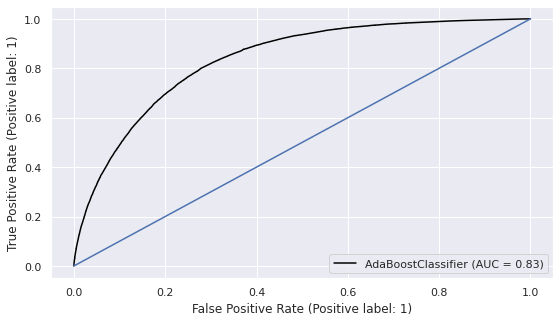

In [ ]:
plot_roc_curve(Ada,xtest,ytest,color='black')
plt.plot([0,1],[0,1])

In [ ]:
print('The Accuracy Score for the training data is:',Ada.score(xtrain,ytrain))
print('The Accuracy Score for the test data is:', Ada.score(xtest,ytest))

The Accuracy Score for the training data is: 0.7580562047480989
The Accuracy Score for the test data is: 0.7586990053074559


Text(57.5, 0.5, 'Actual Values')

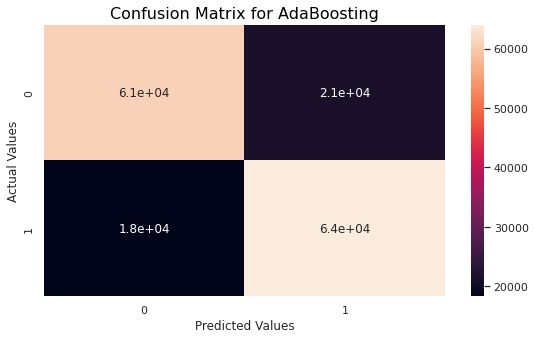

In [ ]:
cm2=confusion_matrix(ytest, y_pred_ada)

sns.heatmap(cm2,annot=True)
plt.title('Confusion Matrix for AdaBoosting',fontdict=font1)
plt.xlabel('Predicted Values')
plt.ylabel('Actual Values')

**6.3.1 K-Fold Cross Validation for AdaBoostClassifier**

In [ ]:
Ada_result1 = cross_val_score(Ada,x_new,y_new,cv=kfold) 
Ada_result1

array([0.65659528, 0.65838062, 0.73417318, 0.61756026, 0.61965532])

In [ ]:
Ada_result1.min()

0.617560255779636

In [ ]:
Ada_result1.max()

0.7341731795740649

In [ ]:
Ada_result1.mean()

0.6572729318542073

**6.3.2 Now, I am using Stratified k fold cross Validation for AdaBoostClassifier**

In [ ]:
Ada_result2= cross_val_score(Ada,x_new,y_new,cv=Skfold)
Ada_result2

array([0.75657433, 0.7581775 , 0.75729172, 0.75678162, 0.75693647])

In [ ]:
Ada_result2.min()

0.7565743330023774

In [ ]:
Ada_result2.max()

0.7581774956049662

In [ ]:
Ada_result2.mean()

0.7571523296135458

**with and without cross Validation Results are mentioned Below:**

In [ ]:
print('The Accuracy score without using cross_Validation is: ', Ada.score(xtest,ytest))
print('The Accuracy Score for the K-Fold Cross_validation is:',Ada_result1.mean())
print('The Accuracy Score for the Stratified K-fold Cross_validation is:',Ada_result2.mean())

The Accuracy score without using cross_Validation is:  0.7586990053074559
The Accuracy Score for the K-Fold Cross_validation is: 0.6572729318542073
The Accuracy Score for the Stratified K-fold Cross_validation is: 0.7571523296135458


# **6.4 XGBoostClassifier Algorithm**

In [ ]:
!pip install xgboost

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import xgboost 
from xgboost import XGBClassifier
XGB=XGBClassifier()

In [ ]:
XGB.fit(xtrain,ytrain)

XGBClassifier()

In [ ]:
y_pred_xgb=XGB.predict(xtest)
y_pred_xgb

array([1, 1, 0, ..., 1, 0, 1])

In [ ]:
from sklearn.metrics import accuracy_score,classification_report,plot_roc_curve

In [ ]:
print( 'The Accuracy score For the XGBoost is:',accuracy_score(ytest,y_pred_xgb) )

The Accuracy score For the XGBoost is: 0.7633141843885495


In [ ]:
print(classification_report(ytest,y_pred_xgb))

              precision    recall  f1-score   support

           0       0.79      0.72      0.75     82285
           1       0.74      0.80      0.77     82389

    accuracy                           0.76    164674
   macro avg       0.77      0.76      0.76    164674
weighted avg       0.77      0.76      0.76    164674



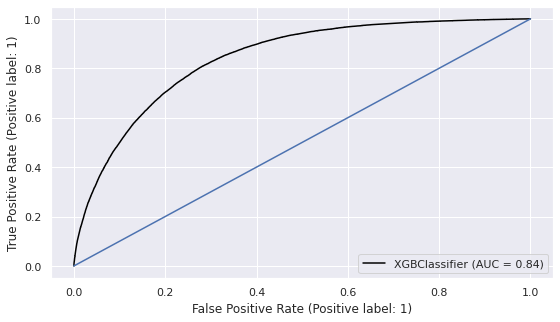

In [ ]:
plot_roc_curve(XGB,xtest,ytest,color='black')
plt.plot([0,1],[0,1])

In [ ]:
#Checking Overfit and Underfit Of Model Accuracy
print('The Accuracy Score for the training data is:',XGB.score(xtrain,ytrain))
print('The Accuracy Score for the test data is:', XGB.score(xtest,ytest))

The Accuracy Score for the training data is: 0.7627355961669591
The Accuracy Score for the test data is: 0.7633141843885495


Text(57.5, 0.5, 'Actual Values')

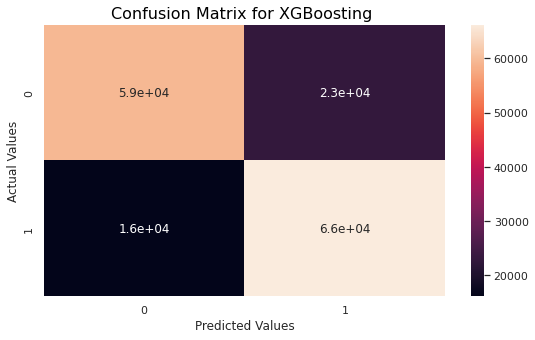

In [ ]:
cm3=confusion_matrix(ytest, y_pred_xgb)

sns.heatmap(cm3,annot=True)
plt.title('Confusion Matrix for XGBoosting ',fontdict=font1)
plt.xlabel('Predicted Values')
plt.ylabel('Actual Values')

**6.4.1 K-Fold Cross Validation for XGBoostClassifier**

In [ ]:
XGB_result1= cross_val_score(XGB,x_new,y_new,cv=kfold)
XGB_result1

array([0.65091134, 0.65288797, 0.73005593, 0.66775974, 0.66867975])

In [ ]:
XGB_result1.min()

0.6509113432863012

In [ ]:
XGB_result1.max()

0.7300559290229728

In [ ]:
XGB_result1.mean()

0.6740589462765969

**6.4.2 Now, I am using Stratified k fold cross Validation for XGBoostClassifier**

In [ ]:
XGB_result2= cross_val_score(XGB,x_new,y_new,cv=Skfold)
XGB_result2

array([0.76204877, 0.76312362, 0.76073491, 0.76129967, 0.76109927])

In [ ]:
XGB_result2.min()

0.7607349110054472

In [ ]:
XGB_result2.max()

0.7631236165890893

In [ ]:
XGB_result2.mean()

0.7616612465205853

**with and without cross Validation Results are mentioned Below:**



In [ ]:
print('The Accuracy score without using cross_Validation is: ', XGB.score(xtest,ytest))
print('The Accuracy Score for the K-Fold Cross_validation is:',XGB_result1.mean())
print('The Accuracy Score for the Stratified K-fold Cross_validation is:',XGB_result2.mean())

The Accuracy score without using cross_Validation is:  0.7633141843885495
The Accuracy Score for the K-Fold Cross_validation is: 0.6740589462765969
The Accuracy Score for the Stratified K-fold Cross_validation is: 0.7616612465205853


# **6.5 Gaussian Naive Baiyes Algorithm**



In [ ]:
from sklearn.naive_bayes import GaussianNB
Gausian_naive=GaussianNB()

In [ ]:
Gausian_naive.fit(xtrain, ytrain)

GaussianNB()

In [ ]:
y_pred_naive=Gausian_naive.predict(xtest)
y_pred_naive

array([1, 1, 0, ..., 1, 1, 1])

In [ ]:
from sklearn.metrics import accuracy_score,classification_report,plot_roc_curve

In [ ]:
print( 'The Accuracy score For the Gausian_naive is:',accuracy_score(ytest,y_pred_naive) )

The Accuracy score For the Gausian_naive is: 0.7021630615640599


In [ ]:
print(classification_report(ytest,y_pred_naive))

              precision    recall  f1-score   support

           0       0.67      0.81      0.73     82285
           1       0.76      0.60      0.67     82389

    accuracy                           0.70    164674
   macro avg       0.71      0.70      0.70    164674
weighted avg       0.71      0.70      0.70    164674



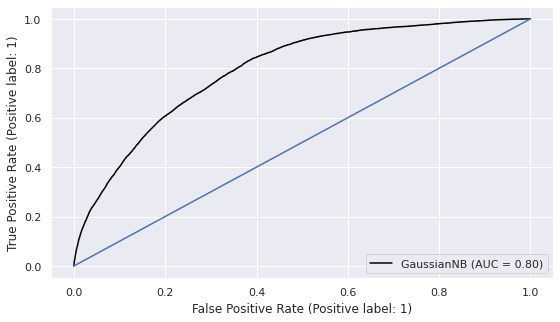

In [ ]:
plot_roc_curve(Gausian_naive,xtest,ytest,color='black')
plt.plot([0,1],[0,1])

In [ ]:
#Checking Overfit and Underfit Of Model Accuracy 
print('The Accuracy Score for the training data is:',Gausian_naive.score(xtrain,ytrain))
print('The Accuracy Score for the test data is:', Gausian_naive.score(xtest,ytest))

The Accuracy Score for the training data is: 0.7017942004695007
The Accuracy Score for the test data is: 0.7021630615640599


Text(57.5, 0.5, 'Actual Values')

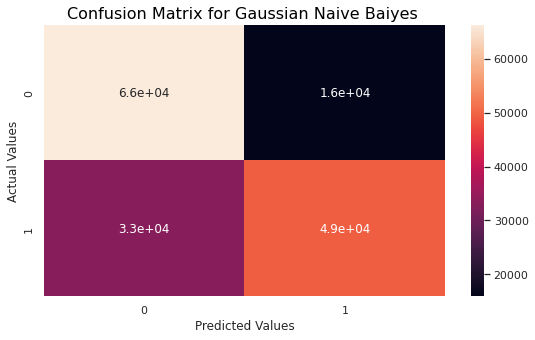

In [ ]:
cm4=confusion_matrix(ytest, y_pred_naive)

sns.heatmap(cm4,annot=True)
plt.title('Confusion Matrix for Gaussian Naive Baiyes ',fontdict=font1)
plt.xlabel('Predicted Values')
plt.ylabel('Actual Values')

**6.5.1 K-Fold Cross Validation for Gausian_naive Classifier**

In [ ]:
Gausian_naive_result1= cross_val_score(Gausian_naive,x_new,y_new,cv=kfold)
Gausian_naive_result1

array([0.76910815, 0.77699644, 0.73261555, 0.55348782, 0.55007196])

In [ ]:
Gausian_naive_result1.min()

0.5500719607950302

In [ ]:
Gausian_naive_result1.max()

0.7769964384285363

In [ ]:
Gausian_naive_result1.mean()

0.6764559834862033

**6.5.2 Stratified K-Fold Cross Validation for Gausian_naive Classifier**

In [ ]:
Gausian_naive_result2= cross_val_score(Gausian_naive,x_new,y_new,cv=Skfold)
Gausian_naive_result2

array([0.70014483, 0.7061658 , 0.7044142 , 0.69733654, 0.69850249])

In [ ]:
Gausian_naive_result2.min()

0.6973365396877448

In [ ]:
Gausian_naive_result2.max()

0.70616579980507

In [ ]:
Gausian_naive_result2.mean()

0.7013127720197647

**with and without cross Validation Results are mentioned Below:**

In [ ]:
print('The Accuracy score without using cross_Validation is: ', Gausian_naive.score(xtest,ytest))
print('The Accuracy Score for the K-Fold Cross_validation is:',Gausian_naive_result1.mean())
print('The Accuracy Score for the Stratified K-fold Cross_validation is:',Gausian_naive_result2.mean())

The Accuracy score without using cross_Validation is:  0.7021630615640599
The Accuracy Score for the K-Fold Cross_validation is: 0.6764559834862033
The Accuracy Score for the Stratified K-fold Cross_validation is: 0.7013127720197647


## **6.6  Multinomial Naive Baiyes Algorithm**

In [ ]:
from sklearn.naive_bayes import MultinomialNB
mnb=MultinomialNB()

In [ ]:
mnb.fit(xtrain,ytrain)

MultinomialNB()

In [ ]:
y_pred_multiNB=mnb.predict(xtest)
y_pred_multiNB

array([1, 1, 0, ..., 1, 0, 1])

In [ ]:
from sklearn.metrics import accuracy_score,classification_report,plot_roc_curve

In [ ]:
print( 'The Accuracy score For Multinomial Naive Baiyes is:',accuracy_score(ytest,y_pred_multiNB) )

The Accuracy score For Multinomial Naive Baiyes is: 0.6228791430341158


In [ ]:
print(classification_report(ytest,y_pred_multiNB))

              precision    recall  f1-score   support

           0       0.58      0.85      0.69     82285
           1       0.73      0.40      0.51     82389

    accuracy                           0.62    164674
   macro avg       0.66      0.62      0.60    164674
weighted avg       0.66      0.62      0.60    164674



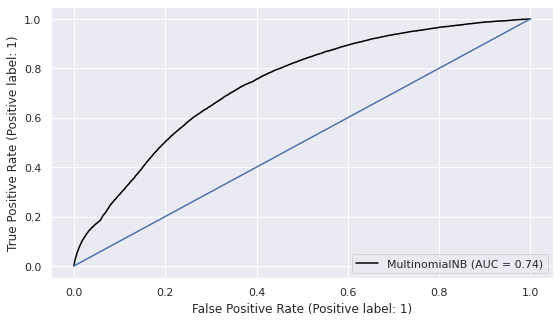

In [ ]:
plot_roc_curve(mnb,xtest,ytest,color='black')
plt.plot([0,1],[0,1])

In [ ]:
#Checking Overfit And Underfit Accuracy 
print('The Accuracy Score for the training data is:',mnb.score(xtrain,ytrain))
print('The Accuracy Score for the test data is:', mnb.score(xtest,ytest))

The Accuracy Score for the training data is: 0.6221977003836164
The Accuracy Score for the test data is: 0.6228791430341158


Text(57.5, 0.5, 'Actual Values')

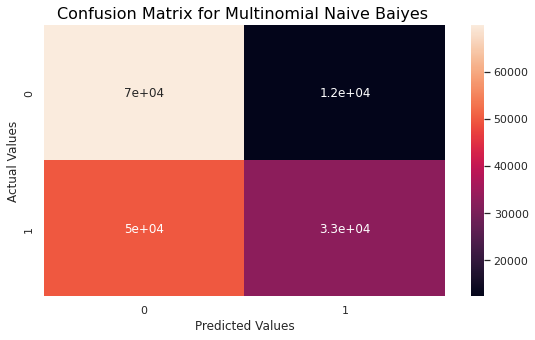

In [ ]:
cm5=confusion_matrix(ytest, y_pred_multiNB)

sns.heatmap(cm5,annot=True)
plt.title('Confusion Matrix for Multinomial Naive Baiyes ',fontdict=font1)
plt.xlabel('Predicted Values')
plt.ylabel('Actual Values')

**6.6.1 K-Fold Cross Validation for Multinomial Naive Baiyes Classifier**

In [ ]:
multi_naive_result1= cross_val_score(mnb,x_new,y_new,cv=kfold)
multi_naive_result1

array([0.80575317, 0.80709217, 0.6994316 , 0.37366781, 0.37249276])

In [ ]:
multi_naive_result1.min()

0.37249275837569

In [ ]:
multi_naive_result1.max()

0.8070921727407704

In [ ]:
multi_naive_result1.mean()

0.6116875027867221

**6.6.2 Stratified K-Fold Cross Validation for Multinomial Naive Baiyes Classifier**

In [ ]:
multi_naive_result2= cross_val_score(mnb,x_new,y_new,cv=Skfold)
multi_naive_result2

array([0.62094313, 0.63036171, 0.62472901, 0.62048423, 0.61723233])

In [ ]:
multi_naive_result2.min()

0.617232333169372

In [ ]:
multi_naive_result2.max()

0.630361713562209

In [ ]:
multi_naive_result2.mean()

0.6227500841579734

**with and without cross Validation Results are mentioned Below:**

In [ ]:
print('The Accuracy score without using cross_Validation is: ', mnb.score(xtest,ytest))
print('The Accuracy Score for the K-Fold Cross_validation is:',multi_naive_result1.mean())
print('The Accuracy Score for the Stratified K-fold Cross_validation is:',multi_naive_result2.mean())

The Accuracy score without using cross_Validation is:  0.6228791430341158
The Accuracy Score for the K-Fold Cross_validation is: 0.6116875027867221
The Accuracy Score for the Stratified K-fold Cross_validation is: 0.6227500841579734


# **6.7 Bernoulli Naive Baiyes Classifier Algorithm**

In [ ]:
from sklearn.naive_bayes import BernoulliNB
bnb=BernoulliNB()

In [ ]:
bnb.fit(xtrain,ytrain)

BernoulliNB()

In [ ]:
y_pred_Bernoli=bnb.predict(xtest)
y_pred_Bernoli

array([1, 1, 0, ..., 1, 1, 1])

In [ ]:
bnb.score(xtest,ytest)

0.7011246462708138

In [ ]:
print(accuracy_score(ytest,y_pred_Bernoli))

0.7011246462708138


In [ ]:
print(classification_report(ytest,y_pred_Bernoli))

              precision    recall  f1-score   support

           0       0.69      0.73      0.71     82285
           1       0.72      0.67      0.69     82389

    accuracy                           0.70    164674
   macro avg       0.70      0.70      0.70    164674
weighted avg       0.70      0.70      0.70    164674



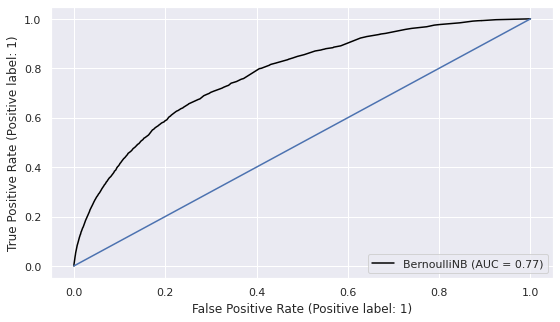

In [ ]:
plot_roc_curve(bnb,xtest,ytest,color='black')
plt.plot([0,1],[0,1])

In [ ]:
#Checking Overfit and underfit Of Model Accuracy 
print('The Accuracy Score for the training data is:',bnb.score(xtrain,ytrain))
print('The Accuracy Score for the test data is:', bnb.score(xtest,ytest))

The Accuracy Score for the training data is: 0.7015287399996877
The Accuracy Score for the test data is: 0.7011246462708138


Text(57.5, 0.5, 'Actual Values')

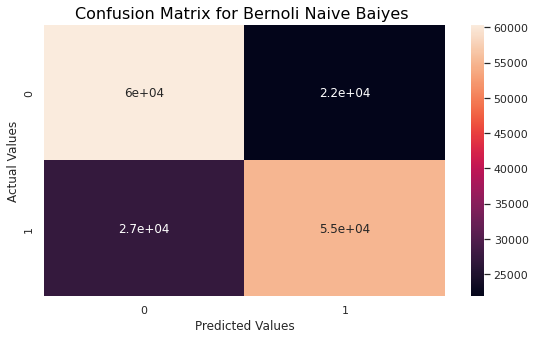

In [ ]:
cm6=confusion_matrix(ytest, y_pred_Bernoli)

sns.heatmap(cm6,annot=True)
plt.title('Confusion Matrix for Bernoli Naive Baiyes ',fontdict=font1)
plt.xlabel('Predicted Values')
plt.ylabel('Actual Values')

**6.7.1 K-Fold Cross Validation for Bernoulli Naive Baiyes Classifier**

In [ ]:
Bernoli_naive_result1= cross_val_score(mnb,x_new,y_new,cv=kfold)
Bernoli_naive_result1

array([0.80575317, 0.80709217, 0.6994316 , 0.37366781, 0.37249276])

In [ ]:
Bernoli_naive_result1.min()

0.37249275837569

In [ ]:
Bernoli_naive_result1.max()

0.8070921727407704

In [ ]:
Bernoli_naive_result1.mean()

0.6116875027867221

**6.7.2 Using Stratified K-Fold Cross Validation for Bernoulli Naive Baiyes Classifier**

In [ ]:
Bernoli_naive_result2= cross_val_score(mnb,x_new,y_new,cv=Skfold)
Bernoli_naive_result2

array([0.62094313, 0.63036171, 0.62472901, 0.62048423, 0.61723233])

In [ ]:
Bernoli_naive_result2.min()

0.617232333169372

In [ ]:
Bernoli_naive_result2.max()

0.630361713562209

In [ ]:
Bernoli_naive_result2.mean()

0.6227500841579734

**with and without cross Validation Results are mentioned Below:**

In [ ]:
print('The Accuracy score without using cross_Validation is: ', bnb.score(xtest,ytest))
print('The Accuracy Score for the K-Fold Cross_validation is:',Bernoli_naive_result1.mean())
print('The Accuracy Score for the Stratified K-fold Cross_validation is:',Bernoli_naive_result2.mean())

The Accuracy score without using cross_Validation is:  0.7011246462708138
The Accuracy Score for the K-Fold Cross_validation is: 0.6116875027867221
The Accuracy Score for the Stratified K-fold Cross_validation is: 0.6227500841579734


# **6.8 Hist GradientBoosting Classifier Algorithm**

In [ ]:
from sklearn.ensemble import HistGradientBoostingClassifier
HGBC=HistGradientBoostingClassifier()

In [ ]:
HGBC.fit(xtrain,ytrain)

HistGradientBoostingClassifier()

In [ ]:
y_pred_histgradient=HGBC.predict(xtest)
y_pred_histgradient

array([1, 1, 0, ..., 1, 0, 1])

In [ ]:
print('The Accuracy Score for the Histgradient is:',accuracy_score(ytest,y_pred_histgradient))

The Accuracy Score for the Histgradient is: 0.7686337855399152


In [ ]:
print(classification_report(ytest,y_pred_histgradient))

              precision    recall  f1-score   support

           0       0.80      0.72      0.76     82285
           1       0.75      0.81      0.78     82389

    accuracy                           0.77    164674
   macro avg       0.77      0.77      0.77    164674
weighted avg       0.77      0.77      0.77    164674



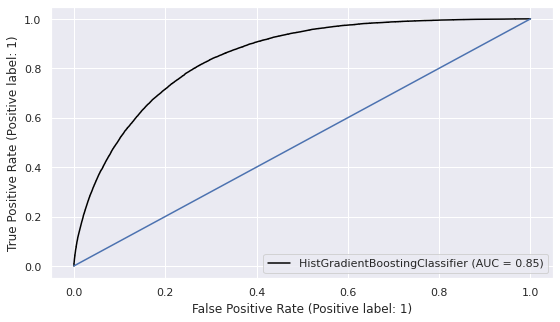

In [ ]:
plot_roc_curve(HGBC,xtest,ytest,color='black')
plt.plot([0,1],[0,1])

In [ ]:
#Checking Overfit and Underfiting Accuracy 

print('The Accuracy Score for the training data is:',HGBC.score(xtrain,ytrain))
print('The Accuracy Score for the test data is:', HGBC.score(xtest,ytest))

The Accuracy Score for the training data is: 0.7693382747151505
The Accuracy Score for the test data is: 0.7686337855399152


Text(57.5, 0.5, 'Actual Values')

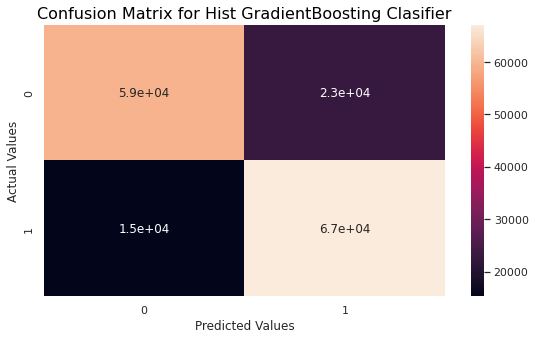

In [ ]:
cm7=confusion_matrix(ytest, y_pred_histgradient)

sns.heatmap(cm7,annot=True)
plt.title('Confusion Matrix for Hist GradientBoosting Clasifier',fontdict=font1)
plt.xlabel('Predicted Values')
plt.ylabel('Actual Values')

**6.8.1 K-Fold Cross Validation for Hist GradientBoosting Classifier**

In [ ]:
Hist_gradient_result1= cross_val_score(HGBC,x_new,y_new,cv=kfold)
Hist_gradient_result1

array([0.65655885, 0.66319011, 0.73527536, 0.68984897, 0.68825491])

In [ ]:
Hist_gradient_result1.min()

0.6565588479090569

In [ ]:
Hist_gradient_result1.max()

0.7352753639030077

In [ ]:
Hist_gradient_result1.mean()

0.6866256403618821

**6.8.2 Stratified K-Fold Cross Validation for Hist GradientBoosting Classifier**

In [ ]:
Hist_gradient_result2= cross_val_score(HGBC,x_new,y_new,cv=Skfold)
Hist_gradient_result2

array([0.76736835, 0.76784202, 0.76433295, 0.76669217, 0.76670128])

In [ ]:
Hist_gradient_result2.min()

0.7643329507569547

In [ ]:
Hist_gradient_result2.max()

0.7678420156126177

In [ ]:
Hist_gradient_result2.mean()

0.7665873545565403

**with and without cross Validation Results are mentioned Below:**

In [ ]:
print('The Accuracy score without using cross_Validation is: ', HGBC.score(xtest,ytest))
print('The Accuracy Score for the K-Fold Cross_validation is:',Hist_gradient_result1.mean())
print('The Accuracy Score for the Stratified K-fold Cross_validation is:',Hist_gradient_result2.mean())

The Accuracy score without using cross_Validation is:  0.7686337855399152
The Accuracy Score for the K-Fold Cross_validation is: 0.6866256403618821
The Accuracy Score for the Stratified K-fold Cross_validation is: 0.7665873545565403


# **6.9 KNeighborsClassifier**

In [ ]:
#import Algorithm
from sklearn.neighbors import KNeighborsClassifier
knn=KNeighborsClassifier()

In [ ]:
knn.fit(xtrain,ytrain)

KNeighborsClassifier()

In [ ]:
y_pred_knn=knn.predict(xtest)

In [ ]:
y_pred_knn

array([1, 1, 0, ..., 1, 0, 1])

In [ ]:
print( 'The Accuracy score For the KNeighborsClassifier is:',accuracy_score(ytest,y_pred_knn) )

The Accuracy score For the KNeighborsClassifier is: 0.8795741890037285


In [ ]:
print(classification_report(ytest,y_pred_knn))

              precision    recall  f1-score   support

           0       0.98      0.77      0.86     82285
           1       0.81      0.99      0.89     82389

    accuracy                           0.88    164674
   macro avg       0.90      0.88      0.88    164674
weighted avg       0.90      0.88      0.88    164674



Text(57.5, 0.5, 'Actual Values')

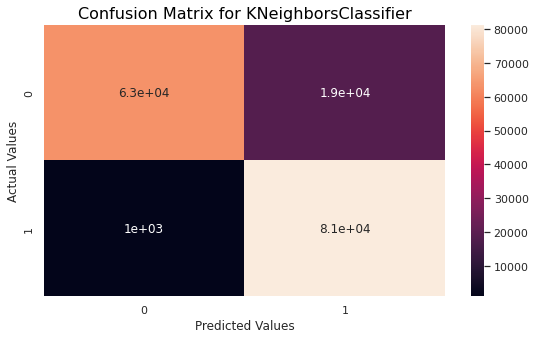

In [ ]:
cm9=confusion_matrix(ytest, y_pred_knn)

sns.heatmap(cm9,annot=True)
plt.title('Confusion Matrix for KNeighborsClassifier',fontdict=font1)
plt.xlabel('Predicted Values')
plt.ylabel('Actual Values')

**6.9.1 K-fold Cross Validation for KNeighborsClassifier**

In [ ]:
knn_result1= cross_val_score(knn,x_new,y_new,cv=kfold)
knn_result1

array([0.76836122, 0.77593981, 0.84563043, 0.9793682 , 0.97830245])

In [ ]:
knn_result1.min()

0.7683612216827742

In [ ]:
knn_result1.max()

0.9793682024375581

In [ ]:
knn_result1.mean()

0.869520423564828

**6.9.2 Stratified K-fold Cross Validation for KNeighborsClassifier**

In [ ]:
knn_result2= cross_val_score(knn,x_new,y_new,cv=Skfold)
knn_result2

array([0.8886804 , 0.88931802, 0.8907289 , 0.89308812, 0.89321565])

In [ ]:
knn_result2.min()

0.8886803967827441

In [ ]:
knn_result2.max()

0.8932156455520941

In [ ]:
knn_result2.mean()

0.8910062159581443

**with and without cross Validation Results are mentioned Below:**

In [ ]:
print('The Accuracy score without using cross_Validation is: ', knn.score(xtest,ytest))
print('The Accuracy Score for the K-Fold Cross_validation is:',knn_result1.mean())
print('The Accuracy Score for the Stratified K-fold Cross_validation is:',knn_result2.mean())

The Accuracy score without using cross_Validation is:  0.8795741890037285
The Accuracy Score for the K-Fold Cross_validation is: 0.869520423564828
The Accuracy Score for the Stratified K-fold Cross_validation is: 0.8910062159581443


# **6.10 Support Vector Mechine Algorithm**

In [ ]:
# import support vector classifier

from sklearn.svm import SVC 
SVC_clf = SVC(kernel='linear')

In [ ]:
SVC_clf.fit(xtrain,ytrain)

In [ ]:
y_pred_svc=SVC_clf.predict(xtest)
y_pred_svc

In [ ]:
print( 'The Accuracy score For the KNeighborsClassifier is:',accuracy_score(ytest,y_pred_svc) )

In [ ]:
print(classification_report(ytest,y_pred_svc))

In [ ]:
#Checking Overfit And Underfit Accuracy 
print('The Accuracy Score for the training data is:',SVC_clf.score(xtrain,ytrain))
print('The Accuracy Score for the test data is:', SVC_clf.score(xtest,ytest))

In [ ]:
cm9=confusion_matrix(ytest, y_pred_svc)

sns.heatmap(cm9,annot=True)
plt.title('Confusion Matrix for Hist Support Vector Machine',fontdict=font1)
plt.xlabel('Predicted Values')
plt.ylabel('Actual Values')

**6.10.1 K-fold Cross Validation for Support Vector Machine**

In [ ]:
svc_result1= cross_val_score(SVC_clf,x_new,y_new,cv=kfold)
svc_result1

In [ ]:
svc_result1.min()

In [ ]:
svc_result1.max()

In [ ]:
svc_result1.mean()

**6.10.2 Stratified K-fold Cross Validation for Support Vector Machine**

In [ ]:
svc_result2= cross_val_score(SVC_clf,x_new,y_new,cv=kfold)
svc_result2

In [ ]:
svc_result2.min()

In [ ]:
svc_result2.max()

In [ ]:
svc_result2.mean()

**with and without cross Validation Results are mentioned Below:**

In [ ]:
print('The Accuracy score without using cross_Validation is: ', SVC_clf.score(xtest,ytest))
print('The Accuracy Score for the K-Fold Cross_validation is:',svc_result1.mean())
print('The Accuracy Score for the Stratified K-fold Cross_validation is:',svc_result2.mean())

From the Machines Learing Analysis, I have been Noticed that DecissionTreeClassifier provide a pretty good result, which is almost 95% and This is the highest accuracy in this Kernel.
I am Also observing that Multinomial Naive Bayes Classifier provide lowest accuracy, which is about 62%.